In [21]:
from models import PreprocessModels
from smoothing import exponential_smoothing, double_exponential_smoothing
from anomalies import segments, detect_anomalies, upper_anomalies, lower_anomalies
from metrics import segment_accuracy
from drain_fuel import segments_drain_fuel, detect_segment
import pandas as pd
import numpy as np

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
sns.set()
from dateutil.parser import parse
import numpy as np
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly
import plotly.graph_objs as go

init_notebook_mode(connected=True)

In [3]:
import warnings                                  # `do not disturbe` mode
warnings.filterwarnings('ignore')

import numpy as np                               # vectors and matrices
import pandas as pd                              # tables and data manipulations
import matplotlib.pyplot as plt                  # plots
import seaborn as sns                            # more plots

from dateutil.relativedelta import relativedelta # working with dates with style
from scipy.optimize import minimize              # for function minimization

import statsmodels.formula.api as smf            # statistics and econometrics
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import scipy.stats as scs

from itertools import product                    # some useful functions
from tqdm import tqdm_notebook



%matplotlib inline

In [4]:
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error

def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [5]:
df1 = pd.read_csv('vehicle1_fuelLevel_public.csv', sep=';')
df2 = pd.read_csv('vehicle1_ingection_public.csv', sep=';')
df3 = pd.read_csv('vehicle1_refueling2_public.csv', sep=';')
df4 = pd.read_csv('vehicle1_speedAndHeight_public.csv', sep=';')
df5 = pd.read_csv('vehicle1_tachometer_public.csv', sep=';')

In [6]:
prep_mod = PreprocessModels(df1,df2,df3,df4,df5)

In [7]:
prep_mod.preprocess_all_df()

In [8]:
def plotGraphics(axes, series, start_vec, end_vec, type_of_data, window=1):
 
    drain, refueling = segments_drain_fuel(series, start_vec, end_vec, type_of_data, window)
    
    axes.add_trace(go.Scatter(
        x=series.index,
        y=series.BEVALUE,
        mode='lines',
        name='oil'
    ))
    
    axes.add_trace(go.Scatter(
        x=drain.index,
        y=drain.BEVALUE,
        mode='lines',
        name='drain'
    ))
    
    axes.add_trace(go.Scatter(
        x=refueling.index,
        y=refueling.BEVALUE,
        mode='lines',
        name='refueling'
    ))

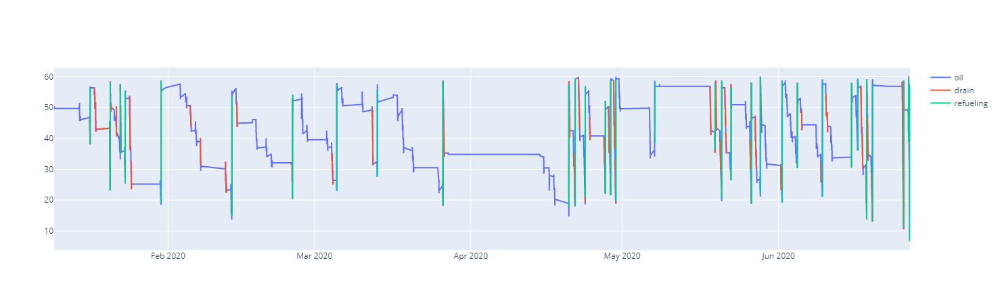

In [9]:
fig = go.Figure()
plotGraphics(fig, prep_mod.df1, prep_mod.df3['STARTDATE'], prep_mod.df3['ENDDATE'], prep_mod.df3['bay/drain'])
fig.show()

In [12]:
def plotMovingAverage(fig, series, check_series, window, plot_intervals=False, scale=1.96, plot_anomalies=False):

    """
        series - dataframe with timeseries
        window - rolling window size 
        plot_intervals - show confidence intervals
        plot_anomalies - show anomalies 

    """
    
    rolling_mean = series.rolling(window=window).mean().dropna()
    
    
    if plot_intervals:
        
        upper_lower_bond, upper_upper_bond = segments(series,scale,window)
        lower_lower_bond, lower_upper_bond = segments(series[::-1],scale,window)
        
        fig.add_trace(go.Scatter(x=upper_upper_bond.index, y=upper_upper_bond.BEVALUE, name='Upper Bond',mode='lines',
                         line = dict(color='firebrick', width=1, dash='dot')))
        fig.add_trace(go.Scatter(x=upper_lower_bond.index, y=upper_lower_bond.BEVALUE, name='Lower Bond',mode='lines',
                         line = dict(color='firebrick', width=1, dash='dot')))
        
        if plot_anomalies:
            
            upper_anomalies = detect_anomalies(series, upper_lower_bond, upper_upper_bond, window)
            lower_anomalies = detect_anomalies(series[::-1], lower_lower_bond, lower_upper_bond, window)

            fig.add_trace(go.Scatter(x=upper_anomalies.index, y=upper_anomalies.BEVALUE,
                    mode='markers', name='upper_markers', marker_size=10, marker_color='rgba(152, 0, 0, .8)'))
            fig.add_trace(go.Scatter(x=lower_anomalies.index, y=lower_anomalies.BEVALUE,
                    mode='markers', name='lower_markers', marker_size=10, marker_color='rgba(152, 0, 0, .8)'))
    
    
    plotGraphics(fig, series[window:], check_series['STARTDATE'], check_series['ENDDATE'], check_series['bay/drain'])
    

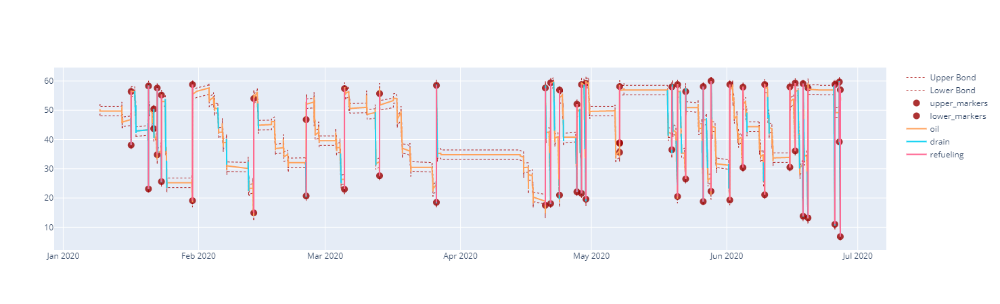

In [13]:
fig = go.Figure()
plotMovingAverage(fig, df1, df3, 2,plot_intervals=True,plot_anomalies=True)
fig.show()

In [14]:
def plotExponentialSmoothing(fig, series, df3, alpha, window=1, scale=1.96):
    """
        Plots exponential smoothing with different alphas
        
        series - dataset with timestamps
        alphas - list of floats, smoothing parameters
        
    """
    plotMovingAverage(fig, exponential_smoothing(series, alpha), df3, window,plot_intervals=True,plot_anomalies=True)

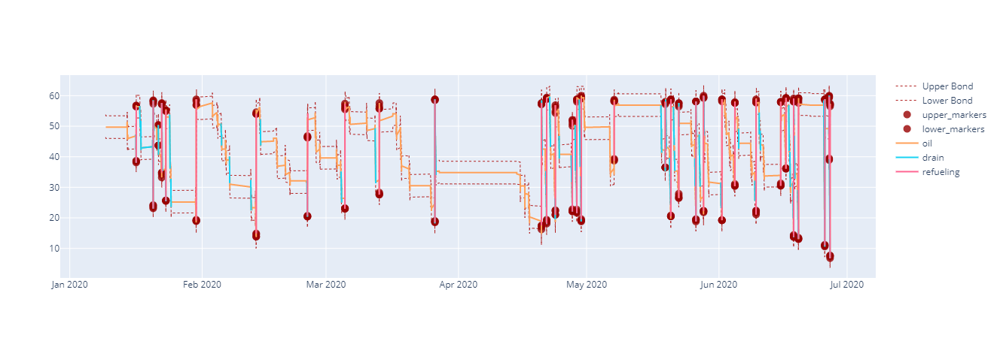

In [15]:
fig = go.Figure()
plotExponentialSmoothing(fig, df1.BEVALUE, df3, alpha=1, window=5)
fig.show()

In [16]:
def plotDoubleExponentialSmoothing(fig, series, df3, alpha, beta, window=1, scale=1.96):
    """
        Plots double exponential smoothing with different alphas and betas
        
        series - dataset with timestamps
        alphas - list of floats, smoothing parameters for level
        betas - list of floats, smoothing parameters for trend
    """
    plotMovingAverage(fig, double_exponential_smoothing(series, alpha, beta), df3, window, plot_intervals=True, plot_anomalies=True, scale=scale)

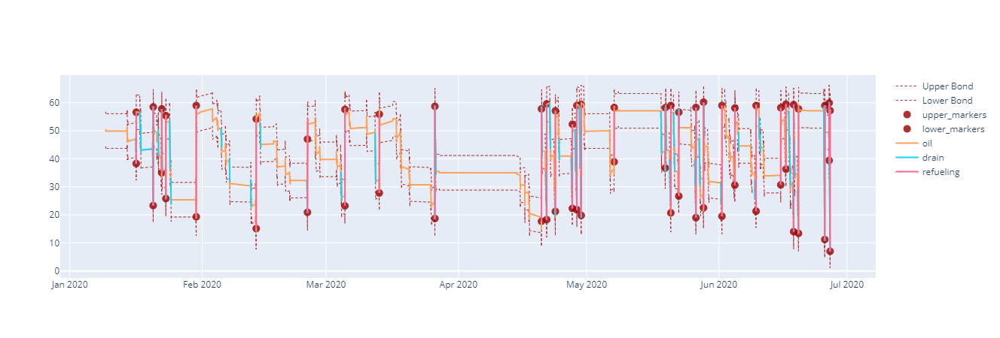

In [17]:
fig = go.Figure()
plotDoubleExponentialSmoothing(fig, df1.BEVALUE, df3, alpha=1, beta=0, window=2, scale=8)
fig.show()

In [25]:
def plotMovingAverageWithPredict(fig, series, df3, predict_series):
    
    plotGraphics(fig, series, df3['STARTDATE'], df3['ENDDATE'], df3['bay/drain'])
    
    fig.add_trace(go.Scatter(
        x=predict_series.index,
        y=predict_series.BEVALUE,
        mode='lines',
        name='predict_fuel'
    ))
    

In [70]:
upp = upper_anomalies(df1.BEVALUE, 1, 0, 2, 6)
low = lower_anomalies(df1.BEVALUE, 1, 0, 2, 6)
drain, refueling = segments_drain_fuel(df1, df3['STARTDATE'], df3['ENDDATE'], df3['bay/drain'])
vec = detect_segment(low,upp,df1)
segment_accuracy(vec, refueling)

BEVALUE    0.410256
dtype: float64

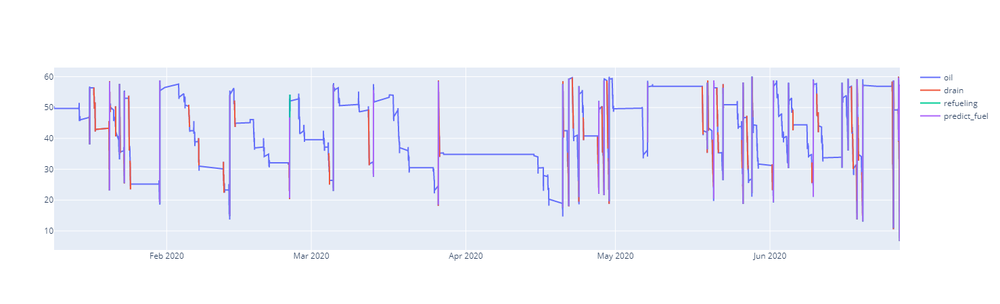

In [28]:
fig = go.Figure()
plotMovingAverageWithPredict(fig, df1, df3, vec)
fig.show()